In [87]:
import os.path
import os
import time
import traceback

import pandas as pd
from shapely.geometry import Polygon, MultiPolygon
import numpy as np

from earthai.init import *
import earthai.chipping.strategy

import geopandas as gpd
import contextily as ctx

import matplotlib.pyplot as plt

import scipy.stats
import sklearn.model_selection

import rasterio
import rasterio.enums
import rasterio.plot
import rasterio.mask
from tqdm import tqdm

%matplotlib inline

pd.set_option('display.max_rows', 100)

from keras_segmentation.models.unet import vgg_unet

In [43]:
# TODO Downsampling should be avoided...

In [44]:
PREFIX = '../../../../../data/'
DATA_PATH = PREFIX + 'filtered-eo-ald-update/'
ANNOTATIONS_PATH = PREFIX + 'filtered-eo-ald-update-annotations/'

CHECKPOINTS_PATH = "/tmp/vgg_unet_1"

TRAIN_PATH = PREFIX + '_train/'
VALIDATE_PATH = PREFIX + '_validate/'
TEST_PATH = PREFIX + '_test/'

PREDICT_PATH = PREFIX + '_predict/'

ZOOM_LEVEL = '17'

In [45]:
if len(os.listdir(TRAIN_PATH)) or len(os.listdir(VALIDATE_PATH)) or len(os.listdir(TEST_PATH)) or len(os.listdir(PREDICT_PATH)):
    print('Warning! Working directories are not empty. Consider delwting contents for working directories.') 

Prepare train, validation and test sets:

In [46]:
available_images = ! ls {DATA_PATH} | grep png$ | grep _{ZOOM_LEVEL}_

In [47]:
trainvalidate_images, test_images = sklearn.model_selection.train_test_split(available_images, test_size=0.3, random_state=3)
train_images, validate_images = sklearn.model_selection.train_test_split(trainvalidate_images, test_size=0.5, random_state=4)

print('Total number of images: {}'.format(len(available_images)))
print('Number of images in training set: {}'.format(len(train_images)))
print('Number of images in validation set: {}'.format(len(validate_images)))
print('Number of images in testing set: {}'.format(len(test_images)))

Total number of images: 120
Number of images in training set: 42
Number of images in validation set: 42
Number of images in testing set: 36


In [48]:
for files, target in zip((train_images, validate_images, test_images), (TRAIN_PATH, VALIDATE_PATH, TEST_PATH)):
    for f in files:
        print('Copying {}{} to {}'.format(DATA_PATH, f, target))
        !cp {DATA_PATH}{f} {target}

Copying ../../../../../data/filtered-eo-ald-update/CHN0176_17_cement.png to ../../../../../data/_train/
Copying ../../../../../data/filtered-eo-ald-update/CHN0157_17_cement.png to ../../../../../data/_train/
Copying ../../../../../data/filtered-eo-ald-update/CHN0408_17_cement.png to ../../../../../data/_train/
Copying ../../../../../data/filtered-eo-ald-update/CHN0800_17_cement.png to ../../../../../data/_train/
Copying ../../../../../data/filtered-eo-ald-update/CHN0825_17_cement.png to ../../../../../data/_train/
Copying ../../../../../data/filtered-eo-ald-update/CHN0164_17_steel.png to ../../../../../data/_train/
Copying ../../../../../data/filtered-eo-ald-update/CHN0169_17_steel.png to ../../../../../data/_train/
Copying ../../../../../data/filtered-eo-ald-update/CHN0108_17_steel.png to ../../../../../data/_train/
Copying ../../../../../data/filtered-eo-ald-update/CHN0374_17_cement.png to ../../../../../data/_train/
Copying ../../../../../data/filtered-eo-ald-update/CHN0329_17_steel

In [84]:
checkpoint_files = !ls {CHECKPOINTS_PATH}*
if len(checkpoint_files):
    print('Warning! Existing checkpoint files found. Consider deleting existing checkpoint files.')

Warning! Existing checkpoint files found.


In [172]:
models = []

for epoch in range(6):
    model = vgg_unet(n_classes=2, input_height=640, input_width=640, encoder_level=2)
    model.train(
        train_images = TRAIN_PATH,
        train_annotations = ANNOTATIONS_PATH,
        validate = True,
        val_images = VALIDATE_PATH,
        val_annotations = ANNOTATIONS_PATH,
        checkpoints_path = CHECKPOINTS_PATH,
        epochs=1,
        do_augment=True,
        auto_resume_checkpoint=True
    )
    
    models.append(model)

Loading the weights from latest checkpoint  /tmp/vgg_unet_1.0
Verifying training dataset


  0%|          | 0/42 [00:00<?, ?it/s]

Dataset verified! 
Verifying validation dataset


100%|██████████| 42/42 [00:08<00:00,  4.93it/s]


Dataset verified! 
Epoch 1/1
512/512 [==============================] - 3247s 6s/step - loss: 0.4830 - accuracy: 0.7779 - val_loss: 0.4673 - val_accuracy: 0.7508
saved  /tmp/vgg_unet_1.0


For training and validation sets and for each epoch, plot harmonic mean of class-wise Intersection over Union score:

In [185]:
def get_binary_classification_auc(model, evaluation_path):
    score = [np.sum(model.predict_segmentation(inp=evaluation_path + test_file)) for test_file in os.listdir(evaluation_path)]
    class_assignments = [True if 'steel' in test_file else False for test_file in os.listdir(evaluation_path)]

    fpr, tpr, _ = sklearn.metrics.roc_curve(class_assignments, score)
    auc = sklearn.metrics.auc(fpr, tpr)
    
    return auc

auc_training = []
auc_validation = []
for model in models:
    for auc_list, path in zip((auc_training, auc_validation), (TRAIN_PATH, VALIDATE_PATH)):
        auc_list.append(get_binary_classification_auc(model, path))

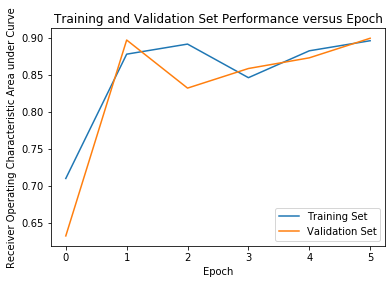

In [187]:
epochs = np.arange(len(auc_training))
plt.plot(epochs, np.column_stack((auc_training, auc_validation)))
plt.title('Training and Validation Set Performance versus Epoch')
plt.xlabel('Epoch')
plt.ylabel('Receiver Operating Characteristic Area under Curve')
plt.xticks(epochs)
plt.legend(('Training Set', 'Validation Set'))
plt.show()

In [188]:
selected_model = models[-1]

In [189]:
!python -m keras_segmentation predict --checkpoints_path={CHECKPOINTS_PATH} --input_path={TEST_PATH} --output_path={PREDICT_PATH}

Using TensorFlow backend.
/opt/conda/lib/python3.7/site-packages/tensorflow/python/framework/dtypes.py:516: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_qint8 = np.dtype([("qint8", np.int8, 1)])
/opt/conda/lib/python3.7/site-packages/tensorflow/python/framework/dtypes.py:517: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_quint8 = np.dtype([("quint8", np.uint8, 1)])
/opt/conda/lib/python3.7/site-packages/tensorflow/python/framework/dtypes.py:518: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_qint16 = np.dtype([("qint16", np.int16, 1)])
/opt/conda/lib/python3.7/site-packages/tensorflow/python/framework/dtypes.py:519: FutureWarn

In [190]:
#python -m keras_segmentation train \
#--checkpoints_path="_checkpoints" \
#--train_images="_train" \
#--train_annotations="_annotations" \
#--val_images="_validate" \
#--val_annotations="_annotations" \
#--n_classes=2 \
#--input_height=640 --input_width=640 \
#--model_name="vgg_unet"

In [191]:
#python -m keras_segmentation predict \
# --checkpoints_path="_checkpoints" \
# --input_path="_test" \
# --output_path="_predict"

In [192]:
#python -m keras_segmentation evaluate_model \
# --checkpoints_path="_checkpoints" \
# --images_path="_test" \
# --segs_path="_annotations"

In [193]:
scaling_factor = 0.20
def read_img(filename, scaling_factor=scaling_factor):
    with rasterio.open(filename) as dataset:
        # resample data to target shape
        data = dataset.read(
            out_shape=(
                dataset.count,
                int(dataset.height * scaling_factor),
                int(dataset.width * scaling_factor)
            ),
            resampling=rasterio.enums.Resampling.bilinear
        )
        return data

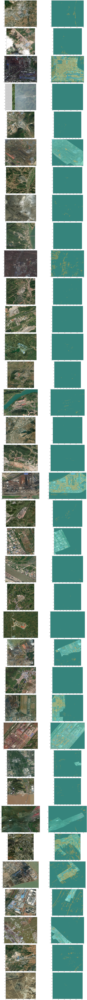

In [194]:
prediction_files = os.listdir(PREDICT_PATH)
fig, axs = plt.subplots(len(prediction_files), 2, figsize=(30, 8 * len(prediction_files)))
for prediction_file, ax in zip(prediction_files, axs):
    img_test = read_img(TEST_PATH + prediction_file)
    rasterio.plot.show(img_test, cmap='terrain', ax=ax[0])
    
    img_annotation = read_img(ANNOTATIONS_PATH + prediction_file)
    rasterio.plot.show(img_test * img_annotation, cmap='terrain', ax=ax[1], alpha=0.7)
    
    img_prediction = read_img(PREDICT_PATH + prediction_file)
    rasterio.plot.show(img_prediction, cmap='terrain', ax=ax[1], alpha=0.4)

plt.tight_layout()
plt.show()    

In [195]:
scores = [np.sum(selected_model.predict_segmentation(inp=TEST_PATH + test_file)) for test_file in os.listdir(TEST_PATH)]
class_assignments = [True if 'steel' in test_file else False for test_file in os.listdir(TEST_PATH)]

fpr, tpr, _ = sklearn.metrics.roc_curve(class_assignments, score)
auc = sklearn.metrics.auc(fpr, tpr)

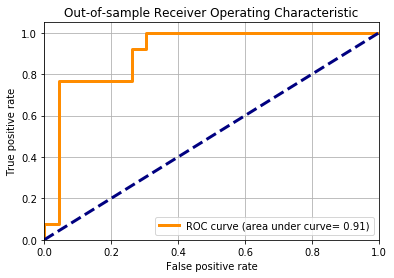

In [196]:
plt.plot(fpr, tpr, color='darkorange', linewidth=3, label='ROC curve (area under curve= %0.2f)' % auc)
plt.plot([0, 1], [0, 1], color='navy', linestyle='--', linewidth=3)
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False positive rate')
plt.ylabel('True positive rate')
plt.title('Out-of-sample Receiver Operating Characteristic')
plt.legend(loc="lower right")
plt.grid(True)
plt.show()